In [99]:
# ======= Importando bibliotecas ======= #
# gerais
import pandas as pd
import numpy as np

# NLP, deep learning
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from my_nlp_library import MyTokenizer
from sklearn.manifold import TSNE
from sklearn.preprocessing import normalize

# visualização
import matplotlib.pyplot as plt
from tqdm import tqdm # This will make a progress bar for us
import plotly.express as px

## 1. Embeddings
### 1.1 Dataset

In [15]:
# Carregar o dataset e modelo
df = pd.read_csv('data/arxiv3.csv')

# retira a primeira coluna e a coluna update_date
df = df.drop(columns=['Unnamed: 0', 'update_date'])

df.head()

,title,authors,abstract,categories
0,Bosonic characters of atomic Cooper pairs acro...,Y. H. Pong and C. K. Law,We study the two-particle wave function of p...,cond-mat.mes-hall
1,Measurement of the Hadronic Form Factor in D0 ...,"The BABAR Collaboration, B. Aubert, et al",The shape of the hadronic form factor f+(q2)...,hep-ex
2,Spectroscopic Properties of Polarons in Strong...,A. S. Mishchenko (1 and 2) and N. Nagaosa (1 a...,We present recent advances in understanding ...,cond-mat.str-el cond-mat.stat-mech
3,Tuning correlation effects with electron-phono...,J.P.Hague and N.d'Ambrumenil,We investigate the effect of tuning the phon...,cond-mat.str-el
4,Convergence of the discrete dipole approximati...,"Maxim A. Yurkin, Valeri P. Maltsev, Alfons G. ...",We performed a rigorous theoretical converge...,physics.optics physics.comp-ph


In [16]:
# Carregando os embeddings do GloVe
def load_glove_vectors(glove_file):
    glove_vectors = {}
    with open(glove_file, 'r', encoding='utf-8') as f:
        for line in f:
            values = line.split()
            word = values[0]
            vector = torch.tensor([float(val) for val in values[1:]], dtype=torch.float32)
            glove_vectors[word] = vector
    return glove_vectors

glove_file = "data/glove.6B.300d.txt" 
glove_vectors = load_glove_vectors(glove_file)


def get_vocabulary_from_glove(glove_vectors):
    vocab = dict()
    inverse_vocab = list()
    vocab["<PAD>"] = 0
    inverse_vocab.append("<PAD>")
    vocab["<UNK>"] = 1
    inverse_vocab.append("<UNK>")
    for word, vector in glove_vectors.items():
        vocab[word] = len(inverse_vocab)
        inverse_vocab.append(word)
    return vocab, inverse_vocab

vocab, inverse_vocab = get_vocabulary_from_glove(glove_vectors)

In [17]:
embedding_dim = 300 
vocab_size = len(glove_vectors) + 2
embedding_glove = nn.Embedding(vocab_size, embedding_dim)

for idx, word in enumerate(inverse_vocab[2:]):
    i = idx + 2
    embedding_glove.weight[idx].data = glove_vectors[word]

print("Embedding layer created with shape:", embedding_glove.weight.shape)

Embedding layer created with shape: torch.Size([400002, 300])


In [18]:
class TextDataset(Dataset):
    def __init__(self, texts, tokenizer, embedding):
        self.texts = texts
        self.tokenizer = tokenizer
        self.embedding_layer = embedding

    def __len__(self):
        return len(self.texts)
    

    def __getitem__(self, idx):
        text = self.texts[idx]
        tokens = self.tokenizer(text)
        
        tokens = np.array(tokens)
        mask = tokens > 1
        x = torch.tensor(tokens)
        x = self.embedding_layer(x)
        pooled = torch.mean(x[mask], dim=0)
        tensor = torch.tensor(pooled)
        return tensor

In [19]:
class Transformador( nn.Module ):
    def __init__(self, n_inputs, n_hidden):
        super().__init__()
        self.layer1 = nn.Linear(n_inputs, n_hidden)
        self.layer2 = nn.Linear(n_hidden, n_inputs)

    def forward(self, x):
        h = self.layer1(x)
        z = self.layer2(h)
        return z, h
    
        

In [20]:
class PreparaTexto( nn.Module ):
    def __init__(self, tokenizer, embedding_layer):
        super().__init__()
        self.tokenizer = tokenizer
        self.embedding_layer = embedding_layer

    def forward(self, x):
        # Tokenize
        tokens = self.tokenizer(x)
        tokens = np.array(tokens)
        mask = tokens > 1
        x = torch.tensor(tokens)
        x = self.embedding_layer(x)
        pooled = torch.mean(x[mask], dim=0)
        return pooled

### 1.3 Treinamento

  0%|          | 0/50 [00:00<?, ?it/s]C:\Users\livia\AppData\Local\Temp\ipykernel_29076\4260337076.py:20: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  tensor = torch.tensor(pooled)
100%|██████████| 50/50 [11:31<00:00, 13.84s/it]


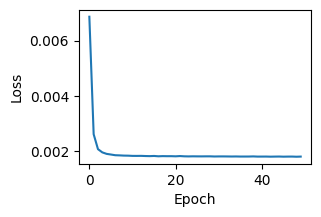

In [21]:
X = df['abstract']


tokenizer = MyTokenizer(sentence_length=800, case_sensitive=False, vocab=vocab, inverse_vocab=inverse_vocab)

dataset = TextDataset(list(X), tokenizer, embedding_glove)
dataloader = DataLoader(dataset, batch_size=64, shuffle=True)

model = Transformador(
    n_inputs=embedding_dim,
    n_hidden=200
)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3) # lr is the learning rate - this is our alpha

criterion = nn.MSELoss()
# And now, a loop that is equal for everyone:
losses = []
for epoch in tqdm(range(50)):
    epoch_loss = 0
    for batch in dataloader:
        X_batch = batch

        optimizer.zero_grad()
        output, _ = model(X_batch)
        
        loss = criterion(output, X_batch)

        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()

    losses.append(epoch_loss / len(dataloader))

plt.figure(figsize=(3,2))
plt.plot(losses)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show() 

## 2. Visualização 

In [22]:

tuned_embeddings = []
pre_trained_embeddings = []
dataloader_no = DataLoader(dataset, batch_size=64, shuffle=False)

with torch.no_grad():
    for batch in dataloader_no:
        X_batch = batch
        _, output= model(X_batch)
        tuned_embeddings.append(output.detach().numpy())
        pre_trained_embeddings.append(X_batch.detach().numpy())

C:\Users\livia\AppData\Local\Temp\ipykernel_29076\4260337076.py:20: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  tensor = torch.tensor(pooled)


In [23]:
embeddings_matrix = torch.tensor(np.concatenate(tuned_embeddings, axis=0))
pre_trained_matrix = torch.tensor(np.concatenate(pre_trained_embeddings, axis=0))

Salvando embeeddings e modelo

In [ ]:
# Salvando embeddings treinados
torch.save(embeddings_matrix, 'data/embeddings_matrix.pt')



In [54]:

# Salvando modelo
torch.save(model.state_dict(), 'data/model.pth')

In [81]:
def get_cluster(matrix ):
    X_viz = matrix.detach().numpy()
    tsne = TSNE(n_components=2, perplexity=3)
    X_proj = tsne.fit_transform(X_viz)

    px.defaults.width = 1500
    px.defaults.height = 1000

    


    df_viz = pd.DataFrame(X_proj, columns=['x', 'y'])
    df_viz['title'] = df['title']
    df_viz['abstract'] = df['abstract']

    # df_viz['category'] = df['categories']


    fig = px.scatter(df_viz, x='x', y='y',   hover_data=['title', 'abstract'])
    fig.update_traces(textposition='top center')
    
    return fig, df_viz



In [82]:
fig1, df1 = get_cluster(embeddings_matrix)

In [83]:
fig1.update_layout(
    title='Cluster de embeddings treinados',
    )

# retirar o abstract do hover_data
fig1.update_traces(hovertemplate="""
                   X: %{x} <br>
                   Y: %{y} <br>
                   Title: %{customdata[0]}""")


fig1.show()

In [84]:
fig2, df2 = get_cluster(pre_trained_matrix)

In [85]:
fig2.update_layout(title='Cluster de embeddings pré-treinados')
fig2.update_traces(hovertemplate="""
                   X: %{x} <br>
                   Y: %{y} <br>
                   Title: %{customdata[0]}""")
fig2.update_traces(marker=dict(color='red'))
fig2.show()

In [55]:
embeddings_matrix

tensor([[ 0.0492,  0.0692,  0.0719,  ..., -0.0099, -0.0109,  0.0050],
        [ 0.0188,  0.0351, -0.0735,  ..., -0.1003,  0.1361, -0.0190],
        [-0.0130,  0.0572,  0.0592,  ...,  0.0407, -0.0833,  0.0380],
        ...,
        [-0.1035, -0.1160, -0.0517,  ...,  0.0217,  0.1983, -0.1229],
        [ 0.0285,  0.0594, -0.0256,  ..., -0.0022,  0.0384,  0.0912],
        [ 0.0764, -0.1061,  0.1694,  ..., -0.0141, -0.0983,  0.0826]])

# Sistema de busca

In [130]:
preparador = PreparaTexto(tokenizer, embedding_glove)

def predict(query, embeddings_matrix, model, preparador):
    query_embedding = preparador(query)
    query_processed = model(query_embedding)[1].detach().numpy() 

    query_processed_ = normalize(query_processed.reshape(1, -1))

    embeddings_matrix_ = normalize(embeddings_matrix)   
    
    R = embeddings_matrix_ @ query_processed_.T

    df_ = df.copy()
    relevance = R.flatten()
    df_["relevance"] = relevance

    df_filtered = df_[relevance > 0.26]
    df_final = df_filtered.sort_values("relevance", ascending=False)

    # Selecionar colunas de interesse
    df_final = df_final[['title', 'abstract', 'relevance']]

    # print the top 10 abstracts
    tam = min(10, len(df_final))
    for i in range(tam):
        print(df_final['abstract'].iloc[i])
        print('-----------------------------------')
        
    return df_final.head(10)



In [107]:
query = "neural network"
df_final = predict(query, embeddings_matrix, model, preparador)
df_final.head(10)

  Passive network tomography uses end-to-end observations of network
communication to characterize the network, for instance to estimate the network
topology and to localize random or adversarial glitches. Under the setting of
linear network coding this work provides a comprehensive study of passive
network tomography in the presence of network (random or adversarial) glitches.
To be concrete, this work is developed along two directions: 1. Tomographic
upper and lower bounds (i.e., the most adverse conditions in each problem
setting under which network tomography is possible, and corresponding schemes
(computationally efficient, if possible) that achieve this performance) are
presented for random linear network coding (RLNC). We consider RLNC designed
with common randomness, i.e., the receiver knows the random code-books all
nodes. (To justify this, we show an upper bound for the problem of topology
estimation in networks using RLNC without common randomness.) In this setting
we presen

,title,abstract,relevance
15617,Passive network tomography for erroneous netwo...,Passive network tomography uses end-to-end o...,0.497372
16595,Scaling properties in spatial networks and its...,Empirical studies on the spatial structures ...,0.463831
15846,General Scheme for Perfect Quantum Network Cod...,This paper considers the problem of efficien...,0.430311
12770,On network coding for sum-networks,A directed acyclic network is considered whe...,0.428197
12628,"A ""Cellular Neuronal"" Approach to Optimization...",The Hopfield-Tank (1985) recurrent neural ne...,0.426711
3732,Optimal network topologies for information tra...,This work clarifies the relation between net...,0.404029
4571,A coordination-based approach to elasticity of...,We study the role of connectivity on the lin...,0.401917
4135,On Metrics for Error Correction in Network Coding,The problem of error correction in both cohe...,0.393825
2641,Security for Wiretap Networks via Rank-Metric ...,The problem of securing a network coding com...,0.381117
4689,Communication over Finite-Field Matrix Channels,This paper is motivated by the problem of er...,0.377021


In [118]:
query = "relational database"
df_final = predict(query, embeddings_matrix, model, preparador)
df_final.head(10)

  We describe the construction and the properties of the SWIRE-SDSS database, a
preliminary derivation of the Far-Infrared Local Luminosity Functions at
24/70/160 micron based on such a database and ways in which VO tools will allow
to refine and extend such work.

-----------------------------------
  ATLAS event data processing requires access to non-event data (detector
conditions, calibrations, etc.) stored in relational databases. The
database-resident data are crucial for the event data reconstruction processing
steps and often required for user analysis. A main focus of ATLAS database
operations is on the worldwide distribution of the Conditions DB data, which
are necessary for every ATLAS data processing job. Since Conditions DB access
is critical for operations with real data, we have developed the system where a
different technology can be used as a redundant backup. Redundant database
operations infrastructure fully satisfies the requirements of ATLAS
reprocessing, which has

,title,abstract,relevance
8540,Local Benchmarks of Infrared Galaxy Evolution ...,We describe the construction and the propert...,0.294527
18230,Scalable Database Access Technologies for ATLA...,ATLAS event data processing requires access ...,0.280929
5516,Quantum Private Queries: security analysis,We present a security analysis of the recent...,0.268648


In [131]:
query = "natural language processing"
df_final = predict(query, embeddings_matrix, model, preparador)
df_final.head(10)

  We prove that the shifted vanishing cycles and nearby cycles commute with
Verdier dualizing up to a {\bf natural} isomorphism, even when the coefficients
are not in a field.

-----------------------------------
  ATLAS event data processing requires access to non-event data (detector
conditions, calibrations, etc.) stored in relational databases. The
database-resident data are crucial for the event data reconstruction processing
steps and often required for user analysis. A main focus of ATLAS database
operations is on the worldwide distribution of the Conditions DB data, which
are necessary for every ATLAS data processing job. Since Conditions DB access
is critical for operations with real data, we have developed the system where a
different technology can be used as a redundant backup. Redundant database
operations infrastructure fully satisfies the requirements of ATLAS
reprocessing, which has been proven on a scale of one billion database queries
during two reprocessing campaigns

,title,abstract,relevance
16271,Natural Commuting of Vanishing Cycles and the ...,We prove that the shifted vanishing cycles a...,0.287000
18230,Scalable Database Access Technologies for ATLA...,ATLAS event data processing requires access ...,0.277380
11651,What is the Value of Joint Processing of Pilot...,The spectral efficiency achievable with join...,0.269891
